In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

from util.plotting import image_grid, plot_distribution, plot_image_grid_extremes

SEED = 5

# Directory paths
dataset_dir = Path("data/invicta_retinal_fundus")

# Load CSV dataset
dataset = pd.read_csv(dataset_dir / "dataset.csv")
dataset.set_index("id", inplace=True)
dataset["path"] = dataset["path"].apply(lambda x: dataset_dir / x)
dataset.head(10)

,dataset,modality,class,path
id,,,,
65778,airogs,glaucoma,0,data/invicta_retinal_fundus/images/65778.png
156822,eyepacs,dr,2,data/invicta_retinal_fundus/images/156822.png
108727,eyepacs,dr,0,data/invicta_retinal_fundus/images/108727.png
121690,eyepacs,dr,1,data/invicta_retinal_fundus/images/121690.png
6299,airogs,glaucoma,0,data/invicta_retinal_fundus/images/6299.png
51154,airogs,glaucoma,0,data/invicta_retinal_fundus/images/51154.png
74899,airogs,glaucoma,0,data/invicta_retinal_fundus/images/74899.png
162329,eyepacs,dr,0,data/invicta_retinal_fundus/images/162329.png
24258,airogs,glaucoma,0,data/invicta_retinal_fundus/images/24258.png


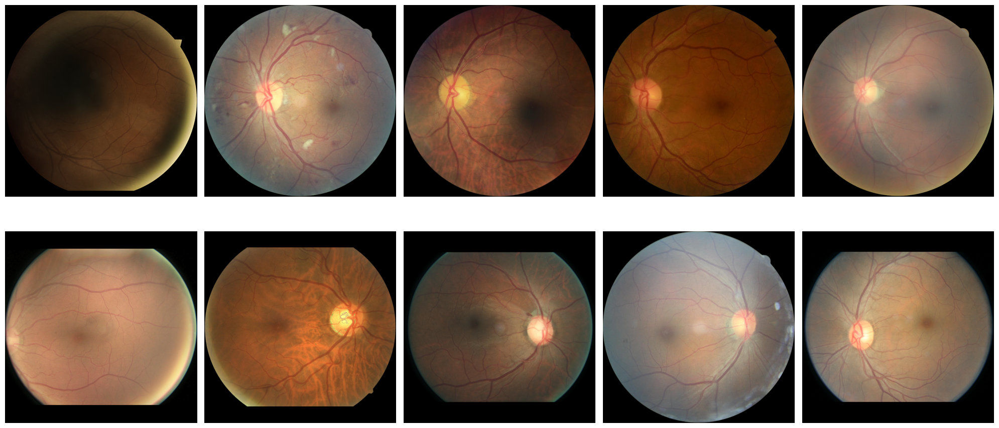

In [2]:
random_sample = dataset.sample(10, random_state=SEED)["path"].values
image_grid(random_sample, n_cols=5)
plt.show()

# Input Validation

As shown in the dataset sample, the images present in this dataset all have different characteristics. Some are slightly more in focus, others are darker and others are more colorful.

We can use **pyMDMA** metrics to quickly assess the quality of these images and what other **unannotated** concepts they contain.  
For this example, we are going to assess the *Contrast*, *Brightness*, *Sharpness*, and *Colorfulness* of the images with the help of pyMDMA.

The dataset that we are using is too large to load into memory, so we are going to use a **DataLoader** to load the images in batches:

In [4]:
from util.data import make_dataloader
from tqdm import tqdm

fundus_dataset, image_loader = make_dataloader(
    dataset_root=dataset_dir,
    transform=None,
    batch_size=30,
)

## Contrast

The **Measure of Enhancement (EME)** is a metric that can be used to measure the contrast of an image, by using concepts related with Webers Low of the human visual system.

Source paper: https://www.researchgate.net/publication/244268659_A_New_Measure_of_Image_Enhancement

In [5]:
from pymdma.image.measures.input_val import EME

eme = EME(blocks_size=(50, 50))

dataset["contrast"] = np.nan
for batch in tqdm(image_loader):
    ids = batch["ids"]
    images = batch["images"]

    # compute contrast levels on a batch
    batch_contrast = eme.compute(images)

    # store contrast levels in the df
    instance_contrast = batch_contrast.value[1]
    dataset.loc[ids, "contrast"] = instance_contrast


100%|██████████| 334/334 [00:58<00:00,  5.67it/s]


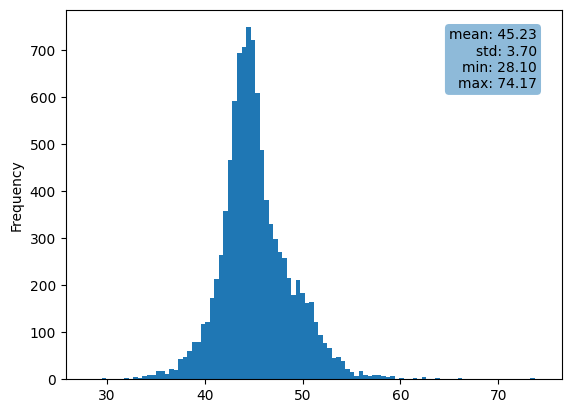

In [6]:
plot_distribution(dataset, "contrast")

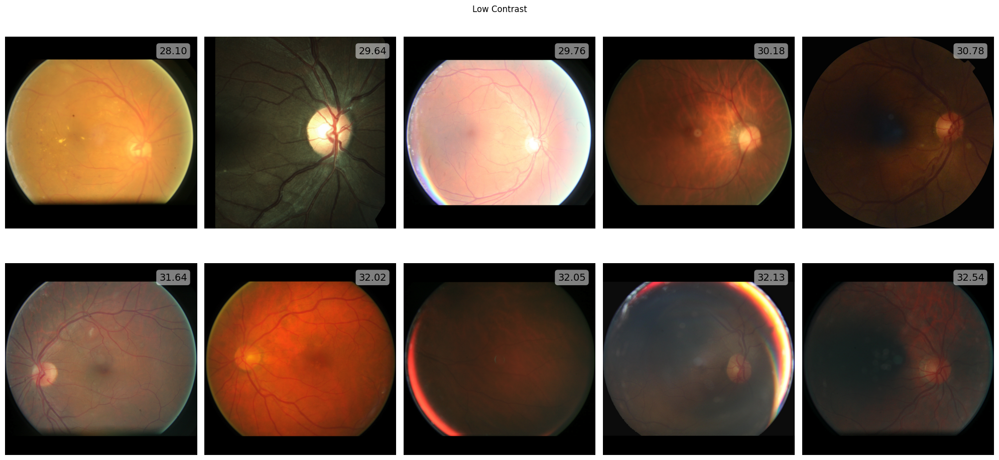

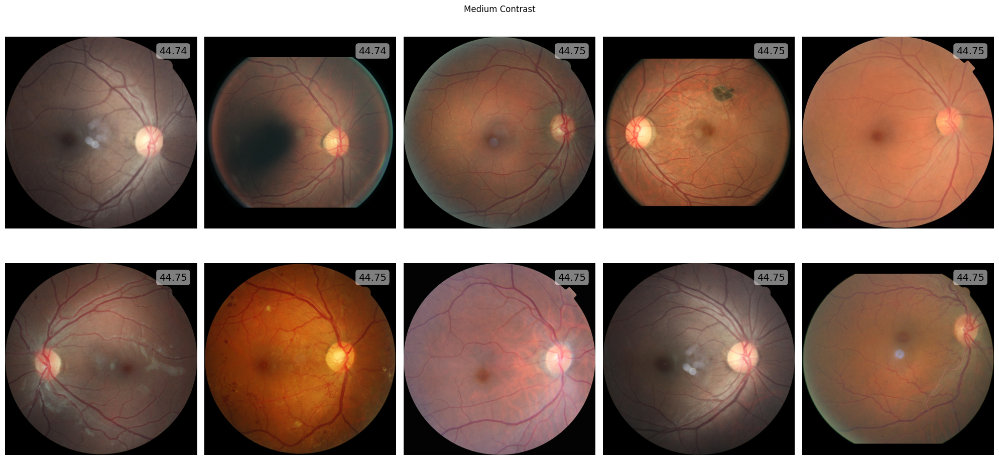

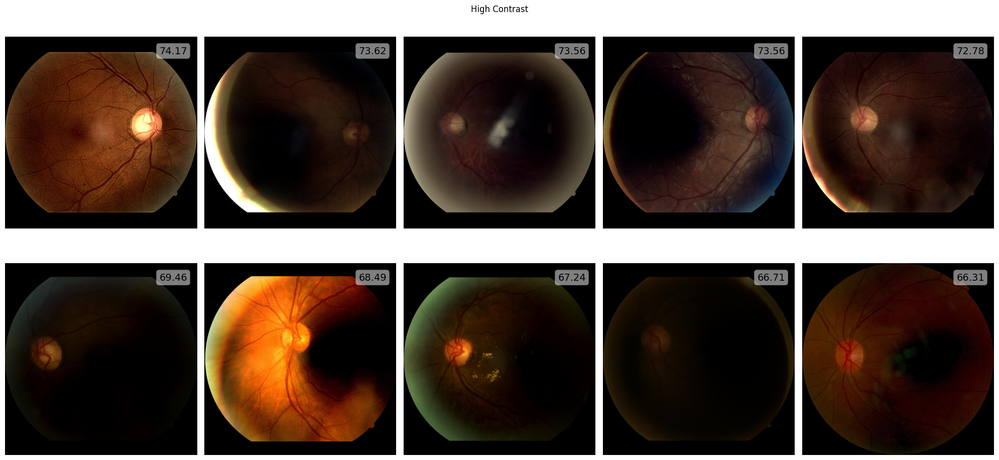

In [7]:
plot_image_grid_extremes(dataset, "contrast")

# Brightness

Measures brightness of images by first mapping them from RBG to the Hue-Saturation-Brightness (HSB) color model and then looking at the Brightness channel.

Reference: https://towardsdatascience.com/measuring-enhancing-image-quality-attributes-234b0f250e10/

In [8]:
from pymdma.image.measures.input_val import Brightness

bright = Brightness()

dataset["brightness"] = np.nan
for batch in tqdm(image_loader):
    ids = batch["ids"]
    images = batch["images"]

    # compute contrast levels on a batch
    batch_bright = bright.compute(images)

    # store contrast levels in the df
    instance_bright = batch_bright.value[1]
    dataset.loc[ids, "brightness"] = instance_bright


100%|██████████| 334/334 [00:42<00:00,  7.90it/s]


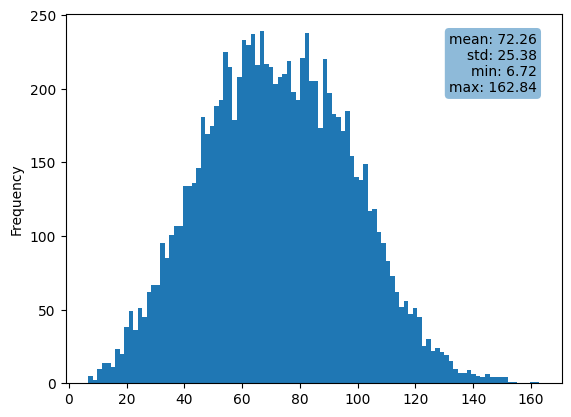

In [9]:
plot_distribution(dataset, "brightness")

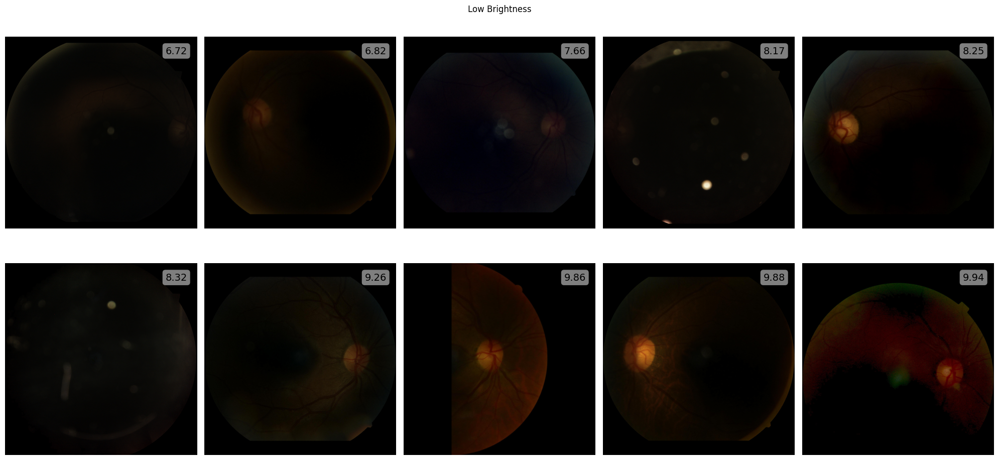

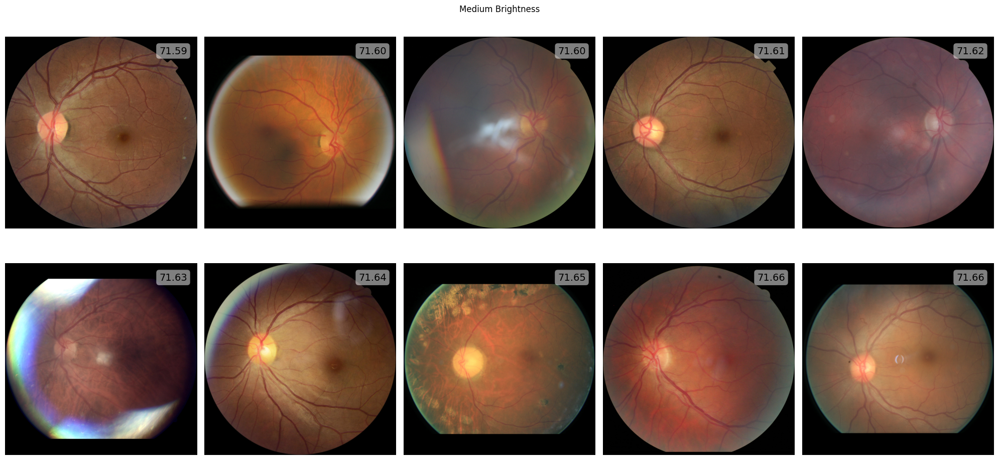

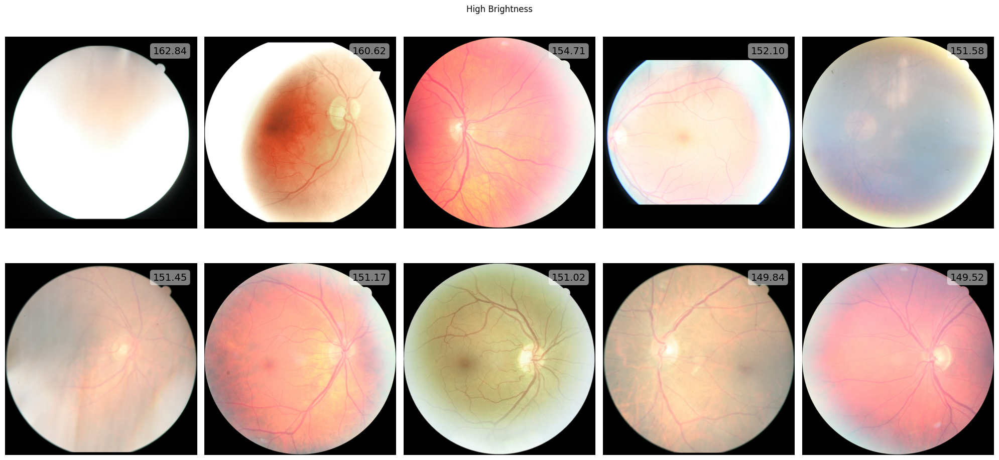

In [10]:
plot_image_grid_extremes(dataset, "brightness")

# Sharpness
Sharpness measure based on the Tenengrad implementation. Applies a Sobel filter to the image and then computes the gradient magnitude.

**Source paper:** https://onlinelibrary.wiley.com/doi/pdf/10.1002/cyto.990060202  
**Additional Reference:** https://ieeexplore.ieee.org/stamp/stamp.jsp?tp=&arnumber=8980980


In [52]:
from pymdma.image.measures.input_val import Tenengrad

tene = Tenengrad()

dataset["sharpness"] = np.nan
for batch in tqdm(image_loader):
    ids = batch["ids"]
    images = batch["images"]

    # compute contrast levels on a batch
    batch_tene = tene.compute(images)

    # store contrast levels in the df
    instance_tene = batch_tene.value[1]
    dataset.loc[ids, "sharpness"] = instance_tene


100%|██████████| 334/334 [01:03<00:00,  5.25it/s]


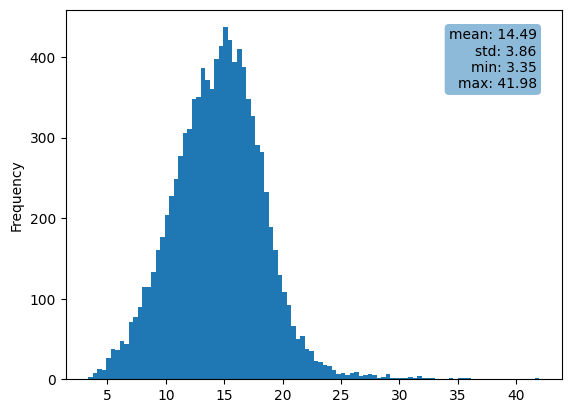

In [54]:
plot_distribution(dataset, "sharpness")

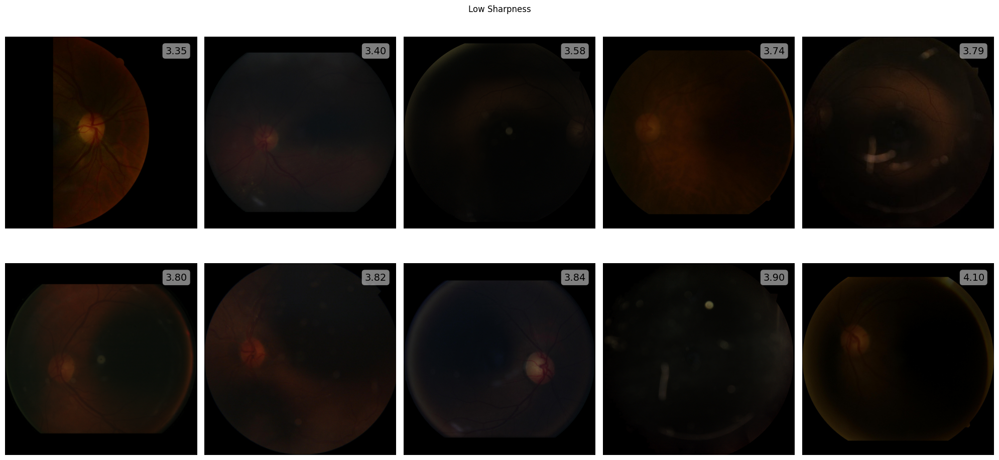

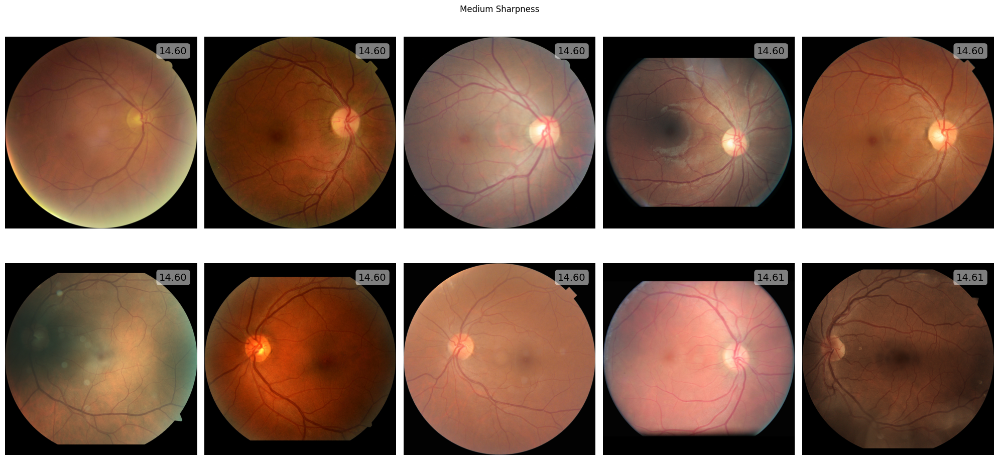

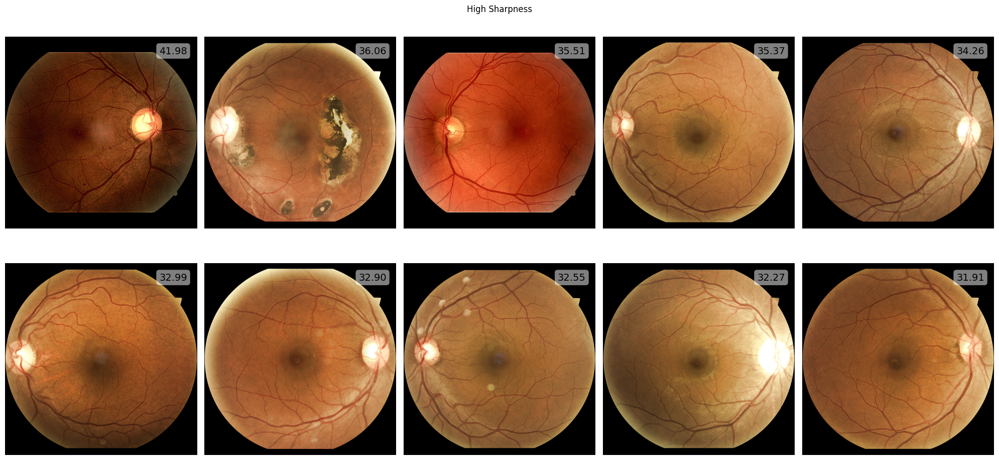

In [36]:
plot_image_grid_extremes(dataset, "sharpness")

# Colorfulness

Measures the colorfulness of images aligned with the human vision system.

**Source paper:** https://infoscience.epfl.ch/server/api/core/bitstreams/77f5adab-e825-4995-92db-c9ff4cd8bf5a/content

In [55]:
from pymdma.image.measures.input_val import Colorfulness

colorfulness = Colorfulness()

dataset["colorfulness"] = np.nan
for batch in tqdm(image_loader):
    ids = batch["ids"]
    images = batch["images"]

    # compute contrast levels on a batch
    batch_color = colorfulness.compute(images)

    # store contrast levels in the df
    instance_color = batch_color.value[1]
    dataset.loc[ids, "colorfulness"] = instance_color


100%|██████████| 334/334 [00:56<00:00,  5.88it/s]


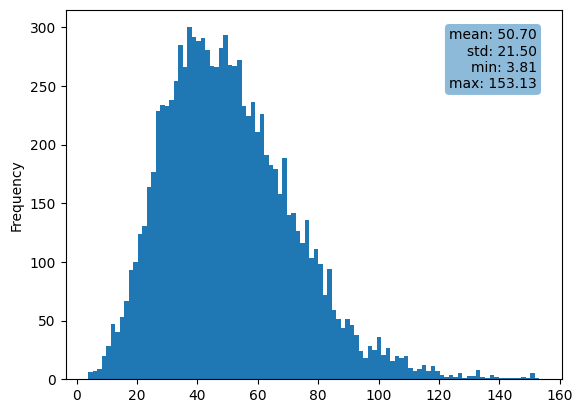

In [56]:
plot_distribution(dataset, "colorfulness")

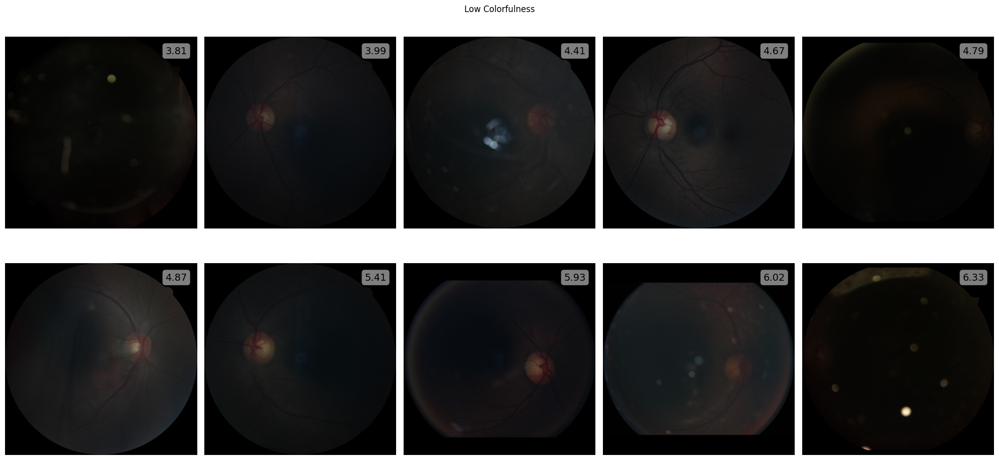

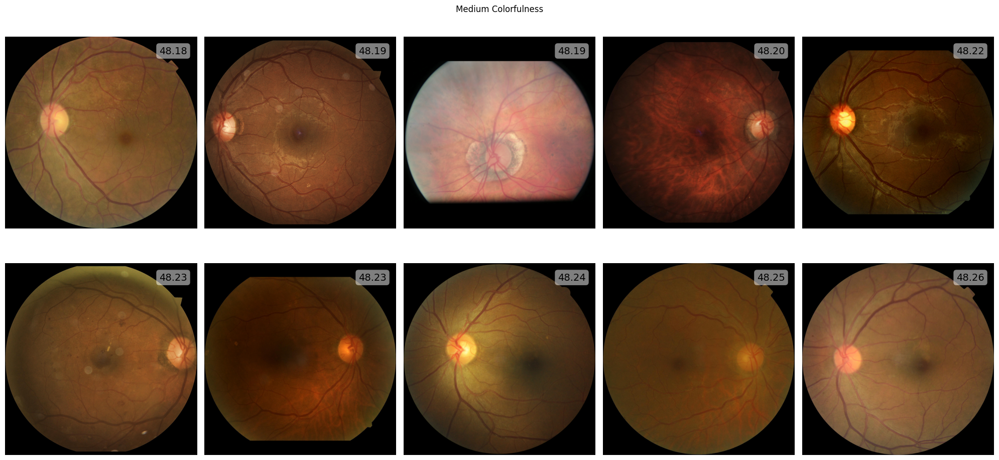

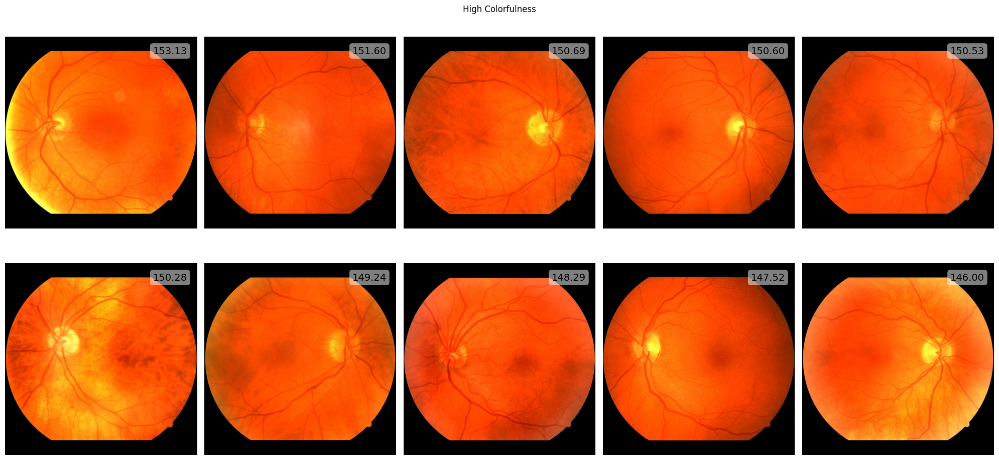

In [57]:
plot_image_grid_extremes(dataset, "colorfulness")

# Dataset Description

Since we have access to these metrics for each image, we can do a simple study of the correlation between the metrics and the class.

First we will determine the correlation between the metrics.

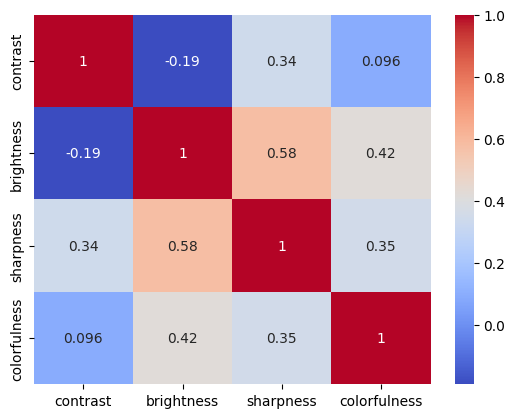

In [ ]:
import seaborn as sns
corr = dataset[["contrast", "brightness", "sharpness", "colorfulness"]].corr()
sns.heatmap(corr, annot=True, cmap="coolwarm")
plt.show()

N samples for 0 class: 3453
N samples for 1 class: 359
N samples for 2 class: 722
N samples for 3 class: 109
N samples for 4 class: 88


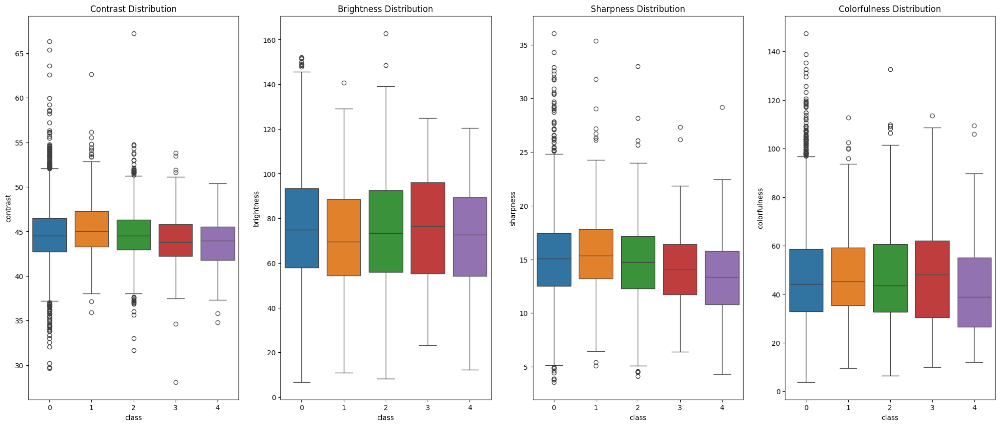

In [58]:
# plot metric distributions by class
dr_groups = dataset[dataset["modality"] == "dr"].groupby("class")
for class_, group in dr_groups:
    print(f"N samples for {class_} class: {len(group)}")

metrics = ["contrast", "brightness", "sharpness", "colorfulness"]
fig, axs = plt.subplots(1, len(metrics), figsize=(25, 10))

for ax, metric in zip(axs, metrics):
    ax.set_title(f"{metric.capitalize()} Distribution")
    for class_, group in dr_groups:
        sns.boxplot(x="class", y=metric, data=group, ax=ax, )

N samples for 0 class: 5106
N samples for 1 class: 163


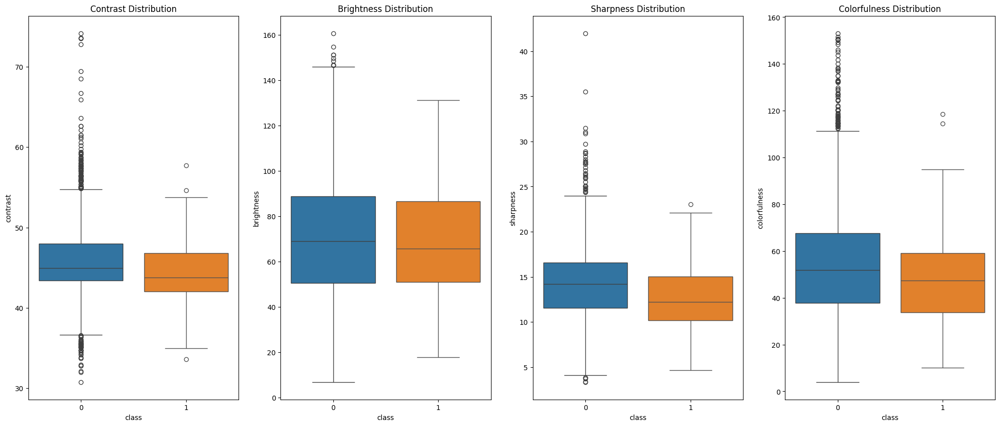

In [42]:
# plot metric distributions by class
dr_groups = dataset[dataset["modality"] == "glaucoma"].groupby("class")

for class_, group in dr_groups:
    print(f"N samples for {class_} class: {len(group)}")

metrics = ["contrast", "brightness", "sharpness", "colorfulness"]
fig, axs = plt.subplots(1, len(metrics), figsize=(25, 10))

for ax, metric in zip(axs, metrics):
    ax.set_title(f"{metric.capitalize()} Distribution")
    for class_, group in dr_groups:
        sns.boxplot(x="class", y=metric, data=group, ax=ax, )

# Wrapping Up

In [59]:
dataset.describe().drop(["class"], axis=1)

,contrast,brightness,sharpness,colorfulness
count,10000.000000,10000.000000,10000.000000,10000.000000
mean,45.234460,72.260678,14.488831,50.695399
std,3.704527,25.383345,3.855248,21.502017
min,28.100649,6.719012,3.349944,3.807495
25%,43.108983,53.801105,11.945797,34.932189
50%,44.748362,71.625900,14.601134,48.222294
75%,47.096594,90.419363,16.960093,63.633051
max,74.172164,162.840820,41.978432,153.130020


In [60]:
dataset

,dataset,modality,class,path,contrast,brightness,sharpness,colorfulness
id,,,,,,,,
65778,airogs,glaucoma,0,data/invicta_retinal_fundus/images/65778.png,44.744098,68.871597,14.969014,20.119099
156822,eyepacs,dr,2,data/invicta_retinal_fundus/images/156822.png,41.905919,109.747787,16.403083,86.496529
108727,eyepacs,dr,0,data/invicta_retinal_fundus/images/108727.png,47.796194,75.538589,17.492305,59.739243
121690,eyepacs,dr,1,data/invicta_retinal_fundus/images/121690.png,48.429779,42.643932,14.680813,55.886112
6299,airogs,glaucoma,0,data/invicta_retinal_fundus/images/6299.png,41.752695,66.144493,10.871019,38.382782
...,...,...,...,...,...,...,...,...
185011,eyepacs,dr,2,data/invicta_retinal_fundus/images/185011.png,40.995002,111.935570,18.256216,32.033852
868,airogs,glaucoma,0,data/invicta_retinal_fundus/images/868.png,44.110638,53.507702,11.550853,51.413738
47436,airogs,glaucoma,0,data/invicta_retinal_fundus/images/47436.png,43.943252,88.910263,14.876202,67.799545


In [61]:
# strip path from df and save
final_dataset = dataset.copy()
final_dataset["path"] = final_dataset["path"].apply(lambda x: "/".join(str(x).split("/")[-2:]))
final_dataset.to_csv(dataset_dir / "input_validation.csv")